# Quantitatively comparing emission models

This jupyter notebook is to demenstrate a fair way to quantitatively compare different emission models between a Gaussian mixture model (GMM), a Gaussian Mixture with exponential signal strength (GMM_exp), and a directional model (VMF). Due to the fact that the three models are defined in different space, such as the GMM and GMM_exp are defined in $\mathbb{R}^N$ state space while the VMF is defined in $(N-1)$-hypersphere surface. Therefore, the traditional marginal log-likelihood based criterion (BIC, Bayes Factor) cannot provide a fair comparison. The main porpuse of this work is trying to propose an unbiased evaluation criterion (goodness of fit test) for the model difend in different space.
<br>

## Emission models description

### 1. Gaussian Mixture model (GMM)

Under the Gaussian mixture model, we model the emissions as a Gaussian with a parcel-specific mean ($\mathbf{v}_k$), and with equal isotropic variance across parcels and observations:

$$
p(\mathbf{y_i}|u^{(k)};\theta_E) = \frac{1}{(2\pi)^{N/2}(\sigma^{2})^{N/2}}\rm{exp}\{-\frac{1}{2\sigma^{2}}(y_{i}-\mathbf{v}_k)^T(y_{i}-\mathbf{v}_k)\}
$$

Since each data dimension is defined by a Gaussian ditribution, the high-dimensional simulation data is defined in between $\color{red}{-\infty}$ to $\color{red}{+\infty}$.

### 2. Gaussian Mixture model with exponential signal strength (GMM_exp)

One issue of the functional activation is that the signal-to-noise ratio (SNR) can be quite different across different participants, and voxels, with many voxels having relatively low SNR. We model this signal to noise for each brain location (and subject) as $s_i \sim Exp(\theta_{\beta s})$. Therefore the probability model for exponential (later on replaced by gamma) is defined as:

$$
p(s_i|\theta) = \beta e^{-\beta s_i}
$$

Overall, the expected signal at each brain location is then $\rm{E}(\mathbf{y}_i)=\mathbf{u}_i^T \mathbf{V}s_i$. Finally, relative to the signal, we assume that the noise is distributed i.i.d Gaussian with $\boldsymbol{\epsilon}_i \sim Normal(0,\mathbf{I}_K\theta_{\sigma s})$. So that, the GMM_exp model probability density function is defined as:

$$
p(\mathbf{y_i}, \mathbf{s_i}|u^{(k)};\theta_E) = \frac{1}{(2\pi)^{N/2}(\sigma^{2})^{N/2}}\rm{exp}\{-\frac{1}{2\sigma^{2}}(y_{i}-\mathbf{v}_k \langle\mathbf{s}_i\rangle^{k})^T(y_{i}-\mathbf{v}_k \langle\mathbf{s}_i\rangle^{k})\}
$$

Since each data dimension is defined by a Gaussian ditribution, the high-dimensional simulation data of GMM_exp is still defined in $\mathbb{R}^N$ space between $\color{red}{-\infty}$ to $\color{red}{+\infty}$.

### 3. von-Mises Fisher Mixture model (VMF)
For a $N$-dimensional data $\mathbf{y} (||\mathbf{y}||_2=1) $ the probability density function of von Mises-Fisher distribution is defined as following,

$$
V_N(\mathbf{y}|\mathbf{v}_k,\kappa) = C_N(\kappa)exp(\kappa\mathbf{v}_k^{T}\mathbf{y})
$$

where $\mathbf{v}_k$ denotes the mean direction (unit vectors for each parcels), $\kappa$ indicates the concentration parameter ($\kappa\geqslant0$), which is joint over all parcels. $C_N(\kappa) = \frac{\kappa^{N/2-1}}{(2\pi)^{N/2}I_{N/2-1}(\kappa)}$ is the normalization constant where $I_r(.)$ refers to the modified Bessel function of the $r$ order. Because the data for fitting VMF must be normalized, such that $\color{red}{(||\mathbf{y}||_2=1)}$, the $N$-dimensional simulation data is then defined on the $(N-1)$-hypershpere's surface with each dimension.

<br>

## Visualizing task-based data

To get us some intuition about what the task-based data looks like, we plot the MDTB data here by randomly select three dimension (conditions) data from a subject.


In [1]:
import os
import sys 
sys.path.append(os.path.abspath('..'))

import numpy as np
import chart_studio.plotly as py
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from depreciated.data_estimation import load_subjectData
import plotly.offline as pyo

pyo.init_notebook_mode()

subj_name = ['s02']
path = 'D:/python_workspace/DCBC/data/%s' % subj_name[0]
data = load_subjectData(path, hemis='L')

# Mean centered
mean = data.mean(axis=1)
data = data - mean[:, np.newaxis]
print(data.shape)

fig = make_subplots(
    rows=2, cols=2,
    specs=[[{'type': 'surface'}, {'type': 'surface'}],
           [{'type': 'surface'}, {'type': 'surface'}]])

# fig = go.Figure()
# fig.add_scatter3d(x=data[:, np.random.randint(34)], y=data[:, np.random.randint(34)], z=data[:, np.random.randint(34)],
#                      mode='markers', marker=dict(size=3, opacity=0.7))
fig.add_trace(
        go.Scatter3d(x=data[:, np.random.randint(34)], y=data[:, np.random.randint(34)], z=data[:, np.random.randint(34)],
                     mode='markers', marker=dict(size=3, opacity=0.7)),
                     row=1, col=1)

fig.add_trace(
        go.Scatter3d(x=data[:, np.random.randint(34)], y=data[:, np.random.randint(34)], z=data[:, np.random.randint(34)],
                     mode='markers', marker=dict(size=3, opacity=0.7)),
                     row=1, col=2)

fig.add_trace(
        go.Scatter3d(x=data[:, np.random.randint(34)], y=data[:, np.random.randint(34)], z=data[:, np.random.randint(34)],
                     mode='markers', marker=dict(size=3, opacity=0.7)),
                     row=2, col=1)

fig.add_trace(
        go.Scatter3d(x=data[:, np.random.randint(34)], y=data[:, np.random.randint(34)], z=data[:, np.random.randint(34)],
                     mode='markers', marker=dict(size=3, opacity=0.7)),
                     row=2, col=2)

fig.update_layout(title_text='Visualizing MDTB dataset of a subject by randomly select 3 conditions', height=800, width=800)

pyo.iplot(fig)

(32492, 34)


By looking at above plot, we understand the task-based data have a `starfish` shape with a big noise in the middle and some signal stretched out to some directions, and they are not regularly placed on a sphere surface.

## Problem Description

The real data is defined in $\mathbb{R}^N$ space, while the data fitting for von-Mises Fisher distribution needs to be normalized on the $(N-1)$-shpere, resulting in the predicted direction $\mu_k$ is a unit vector on the shpere. Therefore, if we want to quantitatively test the goodness of vmf model fitting and compare with other GMM models by some evalution criterion, it will be unfair. For example, the log-likelihood based methods (BIC, Bayes Factor, etc), or marginal log-likelihood for all the components when the model fitting comes to mixture model. These evaluation criterion become biased toward vmf model since it always return a relatively higher log-likelihood (the data is projected onto the sphere and the prediction also on the spherical surface).

In [3]:
import warnings
warnings.filterwarnings('ignore')
import os
import sys 
sys.path.append(os.path.abspath('..'))

from arrangements import ArrangeIndependent
from emissions import MixGaussian, MixVMF
import matplotlib.pyplot as plt
from full_model import FullModel

# Setting up some global constant value for the evaluation
K = 3  # the number of clusters
P = 1000  # the number of data samples
N = 20  # the number of task conditions (dimensionality of the data)
num_sub = 10  # the number of subjects


## Solution 1: Normalize data to unit length

<strike>To test the goodness of model fitting between VMF and GMM, one simple solution would be we fit the two models solely on a dataset generated from a VMF model or normalized GMM. If one model shows better performance in terms of goodness of fit on both data, we can say this model outperforms another. The models fitting solely on the data generated from vmf distribution is easy to implement since both VMF and GMM can be fitted using spherical data. Then we can compared the goodness of model by evaluating their marginal log-likelihood, or other likelihood based criteria (BIC, Bayes factor). 

### 1. Compare GMM and VMF model fitted by data generated from VMF

Firstly, we want to generate the dataset for fitting both GMM and VMF models. Here we generate 10 subjects data from VMF mixture model with each subject's data consist of 3 clusters and 1000 data samples with 20 dimensions.
<strike>

In [7]:
# Step 1: Generate data from VMF mixture model
arrangeT = ArrangeIndependent(K=K, P=P, spatial_specific=False)
emissionT = MixVMF(K=K, N=N, P=P)
U = arrangeT.sample(num_subj=num_sub)
Y1 = emissionT.sample(U)
print(Y1.shape)

(10, 20, 1000)


<strike>In this experiment, we freeze the arrangement model `arrangeT` to be Independent model which means each of the brain location has no relationship with others. Also, we keep the probability of p(U|theta_A) constantly equal to 1/k, which means we do not learn arrangement model so that we only consider the emission log-likelihood changes.<strike>

In [8]:
# Get the true log-likelihood from the true VMF emission model
theta_true = np.concatenate([emissionT.get_params(), arrangeT.get_params()])
emll_true = emissionT._loglikelihood(Y1)
Uhat, ll_a = arrangeT.Estep(emll_true)
loglike_true = np.sum(Uhat * emll_true)


In [9]:
arrangeM = ArrangeIndependent(K=K, P=P, spatial_specific=False)

# Using the data to fit a VMF model
emissionVMF = MixVMF(K=K, N=N, P=P, data=Y1, uniform=False)
M1_vmf = FullModel(arrangeM, emissionVMF)
ll_vmf_1, ll_A_vmf_1, theta_vmf_1, U_hat_vmf_1 = M1_vmf.fit_em(iter=100, tol=0.0001)

# Using the data to fit a GMM model
emissionGMM = MixGaussian(K=K, N=N, P=P, data=Y1)
M1_gmm = FullModel(arrangeM, emissionGMM)
ll_gmm_1, ll_A_gmm_1, theta_gmm_1, U_hat_gmm_1 = M1_gmm.fit_em(iter=100, tol=0.0001)

<strike>Now, we have learned both GMM and VMF model on the data generated from VMF distribution. Then we can compare the marginal log-likelihood and see which gives the maximimal likelihood.<strike>

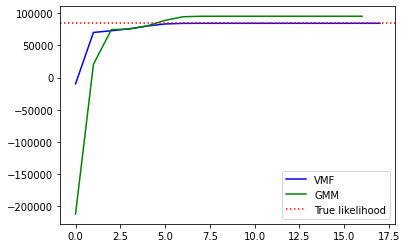

In [10]:
%matplotlib inline
from full_model import _plot_loglike

_plot_loglike(ll_vmf_1-ll_A_vmf_1, loglike_true, ll_gmm_1-ll_A_gmm_1, color='b')

<strike>
### 2. Compare GMM and VMF model fitted by data generated from GMM

Secondly, we want to compare the GMM and VMF models fitted on data generated from GMM. Same as previous experiment settings, here we still generate 10 subjects data from GMM mixture model with each subject's data consist of 3 clusters and 1000 data samples with 20 dimensions.<strike>

In [11]:
emissionT = MixGaussian(K=K, N=N, P=P)
Y2 = emissionT.sample(U)
Y2_raw = Y2.copy()
print(Y2.shape)

(10, 20, 1000)


In [12]:
# Get the true log-likelihood from the true GMM emission model
theta_true = np.concatenate([emissionT.get_params(), arrangeT.get_params()])
emll_true = emissionT._loglikelihood(Y2)
Uhat, ll_a = arrangeT.Estep(emll_true)
loglike_true = np.sum(Uhat * emll_true)

<strike>However, on the other hand, the two models fitting solely using the data generated from GMM is unfair and not doable since the VMF mixture model cannot be fitted using the data that is not spherical. To make it fair, we can normalize the data generated from GMM and fit the two models for comparison.<strike>

In [13]:
# Using the data to fit a GMM model
emissionGMM = MixGaussian(K=K, N=N, P=P, data=Y2)
M2_gmm = FullModel(arrangeM, emissionGMM)
ll_gmm_2, ll_A_gmm_2, theta_gmm_2, U_hat_gmm_2 = M2_gmm.fit_em(iter=100, tol=0.0001)

In [14]:
# standardise Y to unit length
for i in range(num_sub):
    Y2[i, :, :] = Y2[i, :, :] - Y2[i, :, :].mean(axis=0)
    Y2[i, :, :] = Y2[i, :, :] / np.sqrt(np.sum(Y2[i, :, :]**2, axis=0))

print(np.linalg.norm(Y2, axis=1))

# Repeat the model fitting on normalized data
# Using the data to fit a VMF model
emissionVMF = MixVMF(K=K, N=N, P=P, data=Y2, uniform=False)
M2_vmf = FullModel(arrangeM, emissionVMF)
ll_vmf_2, ll_A_vmf_2, theta_vmf_2, U_hat_vmf_2 = M2_vmf.fit_em(iter=100, tol=0.0001)



[[1. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 1. 1. 1.]
 ...
 [1. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 1. 1. 1.]
 [1. 1. 1. ... 1. 1. 1.]]


<strike>Now, we have learned both GMM and VMF model on the data generated from GMM distribution and normalized to unit norm. Then we can compare the marginal log-likelihood and see which one gives best marginal log-likelihood.<strike>

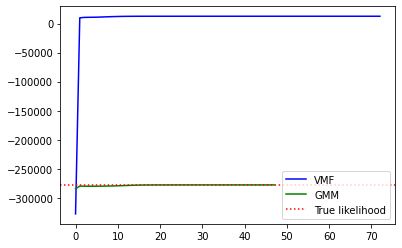

In [15]:
_plot_loglike(ll_vmf_2-ll_A_vmf_2, loglike_true, ll_gmm_2-ll_A_gmm_2, color='b')

<strike>But this method has a major drawback, the performance of GMM fitting will be decreased as a trade-off of normalizing the data. Because, if we look at the shape of the task-evoked fMRI data, we can clearly see that the signal strength is varying across different brain locations. And if we project the data generated from GMM onto the hypersphere, then we will lose this signal strength information and all brain locations have the same SNR, which equals to the norm of the sphere.
<br>

## Solution 2: Adjusted Chi-Square for goodness of fit test (abandoned)

The second idea is to run a goodness of fit based on typical Chi-Square hypothesis test for both GMM and VMF and compare their Chi-square test score or p-value. Same as the solution 1, we first evaluate the two mixture models fitted on the data generated from vmf (|x|2=1) by directly comparing their Chi-square test score. This is because the raw data is spherical data already.<strike>

<strike>The Chi-square test is defined as:
$$
\chi^2 = \sum \frac{(O_i-E_i)^2}{E_i}
$$
In a mixture model, if $v$ independent variables $x_i$ are normally distributed in cluster k with mean $\mu_{x_i}$ and $\sigma_{x_i}^2$, the Chi-square test of goodness of fit for Gaussian Mixture model is then defined as :
$$
\chi^2 = \frac{(x_1-\mu_{x_1})^2}{\sigma_{x_1}^2} + \frac{(x_2-\mu_{x_2})^2}{\sigma_{x_2}^2} + ... +\frac{(x_v-\mu_{x_v})^2}{\sigma_{x_v}^2} = \sum_{i=1}^{v} \frac{(x_i-\mu_{x_i})^2}{\sigma_{x_i}^2}
$$
<strike>
<br>


## Solution 3: Adjusted squared-error for goodness of fit test

The third idea is to calculate typical sum of squared error for all models and compare their test error score, with an exception we calculate an adjusted sse for VMF model.

The adjusted sum of squared error is defined as:
$$
\hat{SSE} = \sum_s\sum_i\sum_k p(u_i=k)(\tilde{y_i}-\mu_i^{(k)})^2
$$

where $u_i=k$ is the assignment of each brain location $i$ to a specific parcel in subject $s$, and the overall probability of a specific brain location being part of parcel $k$ is expressed as $p(u_i=k)$. Therefore, we calculate the mean of the adjusted $SSE$ as $\frac{\hat{SSE}}{PS}$ from total $S$ subjects and $P$ individual brain locations.

<img src="adjusted_SSE.png" alt="Drawing" style="width: 400px;"/>

In [4]:
def mean_adjusted_sse(data, prediction, U_hat, adjusted=True, soft_assign=True):
    """Calculate the adjusted squared error for goodness of model fitting
    Args:
        data: the real mean-centered data, shape (n_subject, n_conditions, n_locations)
        prediction: the predicted mu with shape (n_conditions, n_clusters)
        U_hat: the probability of brain location i belongs to cluster k
        adjusted: True - if calculate adjusted SSE; Otherwise, normal SSE
        soft_assign: True - expected U over all k clusters; False - if take the argmax
                     from the k probability
    Returns:
        The adjusted SSE
    """
    # Step 1: mean-centering the real data and the predicted mu
    data = pt.tensor(np.apply_along_axis(lambda x: x - np.mean(x), 1, data),
                     dtype=pt.get_default_dtype())
    prediction = pt.tensor(np.apply_along_axis(lambda x: x - np.mean(x), 1, prediction),
                           dtype=pt.get_default_dtype())

    # Step 2: get axis information from raw data
    n_sub, N, P = data.shape
    K = prediction.shape[1]
    sse = pt.empty((n_sub, K, P))  # shape [nSubject, K, P]

    # Step 3: if soft_assign is True, which means we will calculate the complete
    # expected SSE for each brain location; Otherwise, we calculate the error only to
    # the prediction that has the maximum probability argmax(p(u_i = k))
    if not soft_assign:
        out = pt.zeros(U_hat.shape)
        idx = U_hat.argmax(dim=1)
        out[np.arange(U_hat.shape[0])[:, None], idx, np.arange(U_hat.shape[2])] = 1
        U_hat = out

    # Step 4: if adjusted is True, we calculate the adjusted SSE; Otherwise normal SSE
    if adjusted:
        mag = pt.sqrt(pt.sum(data**2, dim=1))
        # mag = np.repeat(mag[:, np.newaxis, :], K, axis=1)
        mag = mag.unsqueeze(1).repeat(1, K, 1)
    else:
        mag = pt.ones(sse.shape)

    # Do real SSE calculation SSE = \sum_i\sum_k p(u_i=k)(y_real - y_predicted)^2
    YY = data**2
    uVVu = pt.sum(prediction**2, dim=0)
    for i in range(n_sub):
        YV = pt.mm(data[i, :, :].T, prediction)
        sse[i, :, :] = pt.sum(YY[i, :, :], dim=0) - 2*YV.T + uVVu.reshape((K, 1))
        sse[i, :, :] = sse[i, :, :] * mag[i, :, :]

    return pt.sum(U_hat * sse)/(n_sub * P)

### Step 1: Generate true data from GMM with exponential signal strength

We first generate the true data from a GMM_exp model to fit all three emission models. The signal strength is fitting an exponential distribution with parameter beta (users can change this signal strength to other distribution). We consider this true data is the most closed one to the real data.

In [5]:
from arrangements import ArrangeIndependent
from emissions import MixGaussian, MixVMF, MixGaussianExp
import matplotlib.pyplot as plt
from full_model import FullModel
import torch as pt

K=4  # clusters
N=20  # dimensions
P=1000  # number of brain locations
num_sub=10  # number of subjects

# Step 1: Set the true model to some interesting value
arrangeT = ArrangeIndependent(K=K, P=P, spatial_specific=False, remove_redundancy=False)
emissionT = MixGaussianExp(K=K, N=N, P=P)

# Step 2: Generate data by sampling from the above model
U = arrangeT.sample(num_subj=num_sub)
Y, signal = emissionT.sample(U)
Y_raw = pt.clone(Y)

# standardise Y to unit length for VMF
for i in range(num_sub):
    Y[i, :, :] = Y[i, :, :] - Y[i, :, :].mean(dim=0)
    Y[i, :, :] = Y[i, :, :] / pt.sqrt(pt.sum(Y[i, :, :]**2, dim=0))
    
print(Y_raw.shape)
print(Y.shape)

torch.Size([10, 20, 1000])
torch.Size([10, 20, 1000])


### Step 2: Fit all three emission models using the true data

We then fit all emission models to the true data (Ideally we will use real data to test the emission models). To make the later compare fair enough, we chose to freeze the arrangement model to `Independent` one which means every brain location has no relations with other locations.

### Step 3: Calculating SSE for the emission models

Conbined with step 2, in each given condition (`soft_assign` and `n_clusters`), we calculate standard SSE for the fitted GMM and GMM_exp models since the true data is defined in $\mathbb{R}^N$ space. For the fitted VMF model, we calculate the adjusted SSE because the data fed to the model is normalized to the spherical surface. In this quick experiment, we show the results SSE under two condition variables, the number of clusters `k` and whether complete expected error controlled by `soft_assign`. If `soft_assign=True`, which means we will calculate the complete expected SSE for each brain location $\sum_k p(u_i=k)(\tilde{y_i}-\mu_i^{(k)})^2$; Otherwise, we calculate the error only to the prediction that has the maximum probability, which means $k=argmax(p(u_i))$.

In [6]:
n_clusters = [3, 5, 7, 10]
soft_assign = ['True','False']
res_vmf = np.empty((len(soft_assign), len(n_clusters)))
res_gmm = np.empty((len(soft_assign), len(n_clusters)))
res_gmm_exp = np.empty((len(soft_assign), len(n_clusters)))

In [8]:
for soft in range(len(soft_assign)):
    for k in range(len(n_clusters)):
        arrangeM = ArrangeIndependent(K=n_clusters[k], P=P, spatial_specific=False, remove_redundancy=False)
        
        # Using the data to fit a VMF model
        emissionVMF = MixVMF(K=n_clusters[k], N=N, P=P, uniform=False)
        M_vmf = FullModel(arrangeM, emissionVMF)
        M_vmf, ll_vmf, theta_vmf, U_hat_vmf = M_vmf.fit_em(Y=Y, iter=100, tol=0.0001)

        # Using the data to fit a GMM model
        emissionGMM = MixGaussian(K=n_clusters[k], N=N, P=P)
        M_gmm = FullModel(arrangeM, emissionGMM)
        M_gmm, ll_gmm, theta_gmm, U_hat_gmm = M_gmm.fit_em(Y=Y_raw, iter=100, tol=0.0001)
        
        # Using the data to fit a GMM_exp model
        emissionGMM_exp = MixGaussianExp(K=n_clusters[k], N=N, P=P)
        M_gmm_exp = FullModel(arrangeM, emissionGMM_exp)
        M_gmm_exp, ll_gmm_exp, theta_gmm_exp, U_hat_gmm_exp = M_gmm_exp.fit_em(Y=Y_raw, iter=50, tol=0.01)

        res_vmf[soft, k] = mean_adjusted_sse(Y_raw, M_vmf.emission.V, U_hat_vmf, adjusted=True, soft_assign=soft_assign[soft])
        res_gmm[soft, k] = mean_adjusted_sse(Y_raw, M_gmm.emission.V, U_hat_gmm, adjusted=False, soft_assign=soft_assign[soft])
        res_gmm_exp[soft, k] = mean_adjusted_sse(Y_raw, M_gmm_exp.emission.V, U_hat_gmm_exp, adjusted=False, soft_assign=soft_assign[soft])
        
import pandas as pd
from IPython.display import display

append_str = 'k = '
pre_res = [append_str + str(sub) for sub in n_clusters]
df1 = pd.DataFrame(data=res_vmf, index=["soft_assign", "hard_assign"], columns=pre_res)
df2 = pd.DataFrame(data=res_gmm, index=["soft_assign", "hard_assign"], columns=pre_res)
df3 = pd.DataFrame(data=res_gmm_exp, index=["soft_assign", "hard_assign"], columns=pre_res)

df1.style.highlight_max(color='lightgreen', axis=0)
df2.style.highlight_max(color='lightgreen', axis=0)
df3.style.highlight_max(color='lightgreen', axis=0)

print("VMF:")
display(df1)
print("GMM:")
display(df2)
print("GMM_exp:")
display(df3)

VMF:


,k = 3,k = 5,k = 7,k = 10
soft_assign,60.241161,58.546036,58.439392,58.026176
hard_assign,60.241161,58.546036,58.483376,58.060249


GMM:


,k = 3,k = 5,k = 7,k = 10
soft_assign,14.500634,13.976609,13.829819,13.762296
hard_assign,14.500614,13.976608,13.830173,13.853347


GMM_exp:


,k = 3,k = 5,k = 7,k = 10
soft_assign,15.433261,15.132984,15.015781,14.939429
hard_assign,15.374838,15.137208,15.017576,14.943445


As can be seen in the resultant table, The mean squared error of gaussian mixture model are smaller than the one of von-Mises Fisher Mixture in all k components and soft or hard assigned. This fair comparison tells us that, the GMM is better than VMF mixture model in predicting spherical data.

<br>
<br>
<strike>
    
### 2. Comparing adjusted SSE for the two models fitted using non-spherical data

Secondly, we will perform the adjusted SSE calculation for the two model. However, the data for model fitting of VMF is projected to the sphere with unit norm, then the adjustment of the SSE will be applied for VMF. Same as previous example, we show the resultant adjusted SSE under two condition variables, the number of clusters `k` and whether complete expected error controlled by `soft_assign`. If `soft_assign=True`, which means we will calculate the complete expected SSE for each brain location $\sum_k p(u_i=k)(\tilde{y_i}-\mu_i^{(k)})^2$; Otherwise, we calculate the error only to the prediction that has the maximum probability, which means $k=argmax(p(u_i))$.<strike>

In [48]:
for soft in range(len(soft_assign)):
    for k in range(len(n_clusters)):
        arrangeM = ArrangeIndependent(K=n_clusters[k], P=P, spatial_specific=False)
        
        # Using the data to fit a VMF model
        emissionVMF = MixVMF(K=n_clusters[k], N=N, P=P, data=Y2, uniform=False)
        M1 = FullModel(arrangeM, emissionVMF)
        ll, ll_A, theta, U_hat_vmf_2 = M1.fit_em(iter=100, tol=0.01)

        # Using the data to fit a GMM model
        emissionGMM = MixGaussian(K=n_clusters[k], N=N, P=P, data=Y2_raw)
        M2 = FullModel(arrangeM, emissionGMM)
        ll, ll_A, theta, U_hat_gmm_2 = M2.fit_em(iter=100, tol=0.01)

        res_vmf[soft, k] = mean_adjusted_sse(Y2_raw, M1.emission.V, U_hat_vmf_2, adjusted=True, soft_assign=soft_assign[soft])
        res_gmm[soft, k] = mean_adjusted_sse(Y2_raw, M2.emission.V, U_hat_gmm_2, adjusted=False, soft_assign=soft_assign[soft])

        
import pandas as pd

df1 = pd.DataFrame(data=res_vmf, index=["soft_assign", "hard_assign"], columns=pre_res)
df2 = pd.DataFrame(data=res_gmm, index=["soft_assign", "hard_assign"], columns=pre_res)
print(df1)
print(df2)

                 k = 3      k = 5      k = 7     k = 10
soft_assign  45.454959  45.140718  44.724982  44.336226
hard_assign  45.455200  45.094542  44.825190  44.310589
                 k = 3      k = 5      k = 7     k = 10
soft_assign  12.143703  12.084128  11.992880  11.874221
hard_assign  12.143680  12.082176  11.988508  11.877930


<strike>As can be seen in the above resultant table for non-spherical data, The mean squared error of gaussian mixture model are smaller than the adjusted one of von-Mises Fisher Mixture in all k components and soft or hard assigned. This fair comparison tells us that, the GMM is better than VMF mixture model in predicting non-spherical data.<strike>